In [12]:
import pandas as pd

df_flft1=pd.read_csv("FLFT1.csv")
df_flft2=pd.read_csv("FLFT2.csv")

df_ft1_121=pd.read_csv("FT1_121.csv")
df_ft1_122=pd.read_csv("FT1_122.csv")

df_FT01=pd.read_csv("SENT_SORGJERDET_FT01_F_CV.csv")

df_flft1=df_flft1[["_time","_value"]]
df_flft2=df_flft2[["_time","_value"]]

df_ft1_121=df_ft1_121[["_time","_value"]]
df_ft1_122=df_ft1_122[["_time","_value"]]

df_FT01=df_FT01[["_time","_value"]]

df_flft1['_time'] = pd.to_datetime(df_flft1['_time'])
df_flft2['_time'] = pd.to_datetime(df_flft2['_time'])

df_ft1_121['_time'] = pd.to_datetime(df_ft1_121['_time'])
df_ft1_122['_time'] = pd.to_datetime(df_ft1_122['_time'])

df_FT01['_time'] = pd.to_datetime(df_FT01['_time'])

df_flft1 = df_flft1.set_index('_time')
df_flft2 = df_flft2.set_index('_time')

df_ft1_121 = df_ft1_121.set_index('_time')
df_ft1_122 = df_ft1_122.set_index('_time')

df_FT01 = df_FT01.set_index('_time')

df=pd.concat([df_flft1,df_flft2,df_ft1_121,df_ft1_122,df_FT01], axis=1)
df.columns=["FLFT1","FLFT2","FT1_121","FT1_122","FT01"]

df



,FLFT1,FLFT2,FT1_121,FT1_122,FT01
_time,,,,,
2015-01-01 00:00:00+00:00,0.860849,NaN,NaN,NaN,NaN
2015-01-01 01:00:00+00:00,0.822877,NaN,NaN,NaN,NaN
2015-01-01 02:00:00+00:00,0.693443,NaN,NaN,NaN,NaN
2015-01-01 03:00:00+00:00,0.856340,NaN,NaN,NaN,NaN
2015-01-01 04:00:00+00:00,0.654849,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2020-12-31 19:00:00+00:00,0.668768,0.684115,1.876856,10.339430,3.265707
2020-12-31 20:00:00+00:00,0.710745,0.550334,1.522765,9.405928,4.391712
2020-12-31 21:00:00+00:00,0.671079,0.502749,1.585520,9.283752,4.020866


In [13]:
import chart_studio.plotly as py
import cufflinks as cf
import seaborn as sns
import plotly.express as px
%matplotlib inline

# Make Plotly work in your Jupyter Notebook
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
# Use Plotly locally
cf.go_offline()

In [14]:
df2=df.loc['2016-01-01 00:00:00+00:00':'2021-01-01 23:00:00+00:00']
df2.iplot()

<AxesSubplot:xlabel='_time'>

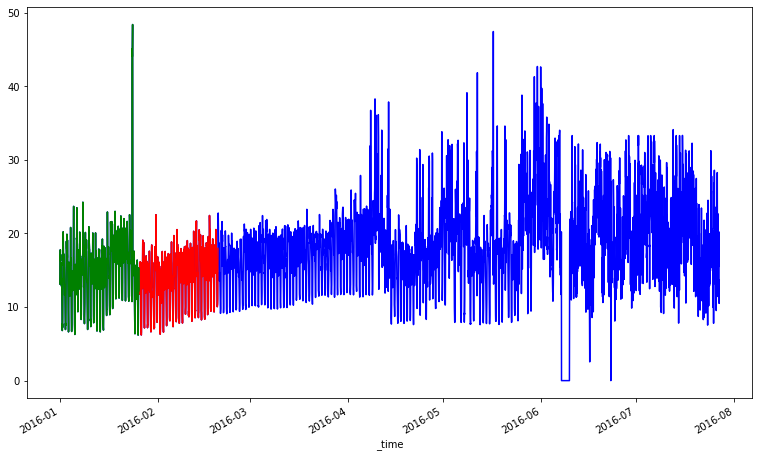

In [15]:
#Test fra jone
df=pd.read_csv("FT1_122.csv")
df=df[["_time","_value"]]
df=df[0:5000]
df['_time'] = pd.to_datetime(df['_time'])

df["hour_in_week"]=df["_time"].dt.weekday*24+df["_time"].dt.hour

df=df.set_index('_time')
ax=df["_value"].plot(figsize=(13,8),c="b")
df_train=df[600:1200]
df_train["_value"].plot(ax=ax,c="r")
df_test=df[0:600]
df_test["_value"].plot(ax=ax,c="g")


In [16]:
df_test["_value"].iplot()

In [17]:
df3=df['FLFT2'].loc['2016-01-01 00:00:00+00:00':'2021-01-01 23:00:00+00:00']
df3.plot(figsize=(30, 10))

KeyError: 'FLFT2'

<AxesSubplot:xlabel='_time'>

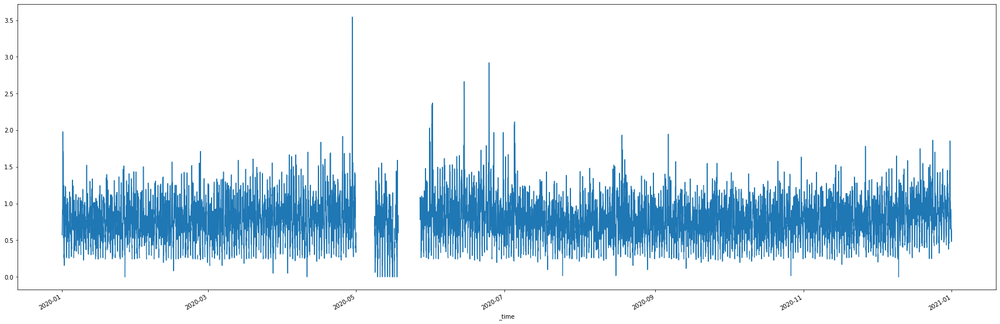

In [ ]:

df3=df3.loc['2019-01-01 00:00:00+00:00':'2021-01-01 23:00:00+00:00']
df3.plot(figsize=(30, 10))

Text(0, 0.5, 'Strømning FLFT1')

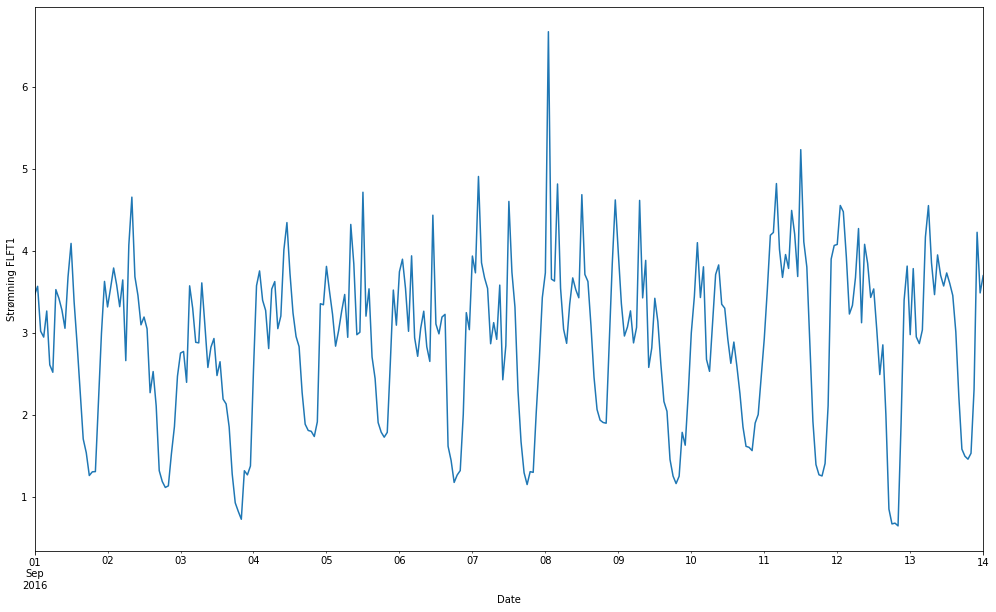

In [ ]:
df3=df['FT1_134'].loc['2016-09-01 00:00:00+00:00':'2016-09-14 00:00:00+00:00']
df3.index.names = ['Date']
ax=df3.plot(figsize=(17, 10))
ax.set_ylabel("Strømning FLFT1")

In [ ]:
df3=pd.DataFrame(df3)
df3

,FT1_134
Date,
2016-09-01 00:00:00+00:00,3.462292
2016-09-01 01:00:00+00:00,3.565670
2016-09-01 02:00:00+00:00,3.018812
2016-09-01 03:00:00+00:00,2.946925
2016-09-01 04:00:00+00:00,3.264735
...,...
2016-09-13 20:00:00+00:00,1.531075
2016-09-13 21:00:00+00:00,2.309110
2016-09-13 22:00:00+00:00,4.224051


C:\Users\peder\AppData\Local\Temp/ipykernel_14784/1225555337.py:3: FutureWarning: the 'freq'' keyword is deprecated, use 'period' instead
  result=seasonal_decompose(df3, model='additive', freq=24)


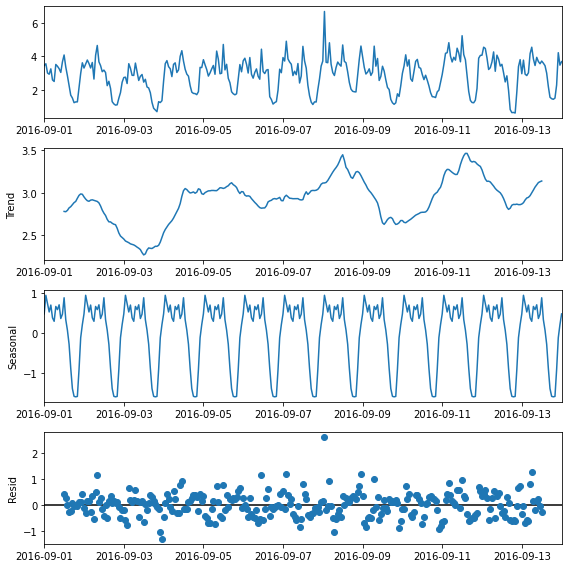

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib as plt
result=seasonal_decompose(df3, model='additive', freq=24)
with plt.rc_context():
    plt.rc("figure", figsize=(8,8))
    result.plot()

In [ ]:
result.resid

Date
2016-09-01 00:00:00+00:00   NaN
2016-09-01 01:00:00+00:00   NaN
2016-09-01 02:00:00+00:00   NaN
2016-09-01 03:00:00+00:00   NaN
2016-09-01 04:00:00+00:00   NaN
                             ..
2016-09-13 20:00:00+00:00   NaN
2016-09-13 21:00:00+00:00   NaN
2016-09-13 22:00:00+00:00   NaN
2016-09-13 23:00:00+00:00   NaN
2016-09-14 00:00:00+00:00   NaN
Name: resid, Length: 313, dtype: float64

In [ ]:
df3["resid"]=result.resid
df3

,FT1_134,resid
Date,,
2016-09-01 00:00:00+00:00,3.462292,NaN
2016-09-01 01:00:00+00:00,3.565670,NaN
2016-09-01 02:00:00+00:00,3.018812,NaN
2016-09-01 03:00:00+00:00,2.946925,NaN
2016-09-01 04:00:00+00:00,3.264735,NaN
...,...,...
2016-09-13 20:00:00+00:00,1.531075,NaN
2016-09-13 21:00:00+00:00,2.309110,NaN
2016-09-13 22:00:00+00:00,4.224051,NaN


In [ ]:
df3["resid"]=result.resid
df3["trend"]=result.trend
df3["seasonal"]=result.seasonal
df3.dropna(inplace=True)
df3

,FT1_134,resid,trend,seasonal
Date,,,,
2016-09-01 12:00:00+00:00,4.088525,0.429596,2.781412,0.877516
2016-09-01 13:00:00+00:00,3.378829,0.268072,2.777892,0.332865
2016-09-01 14:00:00+00:00,2.856163,-0.008443,2.793496,0.071110
2016-09-01 15:00:00+00:00,2.274205,-0.269793,2.822775,-0.278778
2016-09-01 16:00:00+00:00,1.705420,-0.255540,2.837108,-0.876148
...,...,...,...,...
2016-09-13 08:00:00+00:00,3.464468,-0.185009,3.067077,0.582401
2016-09-13 09:00:00+00:00,3.948425,0.151922,3.094093,0.702410
2016-09-13 10:00:00+00:00,3.700214,0.219052,3.119863,0.361299


In [ ]:
df3["trendseas"]=df3["trend"]+df3["seasonal"]

<AxesSubplot:xlabel='Date'>

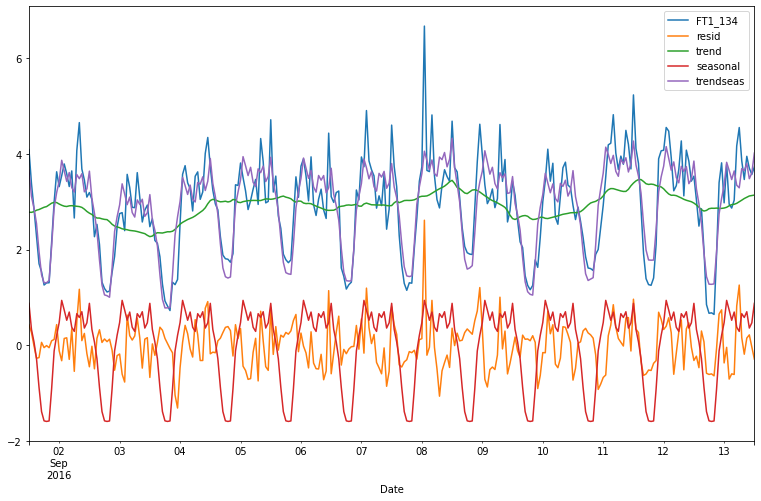

In [ ]:
df3.plot(figsize=(13,8))

<AxesSubplot:>

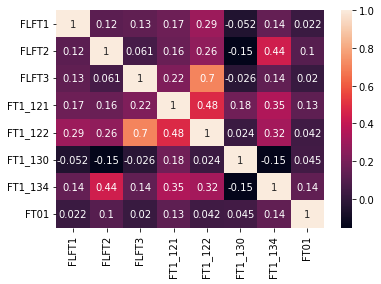

In [ ]:
import seaborn as sns
Var_Corr = df.corr()
sns.heatmap(Var_Corr, xticklabels=Var_Corr.columns, yticklabels=Var_Corr.columns, annot=True)